<a href="https://colab.research.google.com/github/elekdra01/Data-Visualization/blob/master/preprocessing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import re
import string
import nltk  
import sys
import numpy
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
#To format display
pd.set_option('max_rows', 99999)
pd.set_option('max_colwidth', 1000)
pd.describe_option('max_colwidth')
numpy.set_printoptions(threshold=sys.maxsize)

display.max_colwidth : int or None
    The maximum width in characters of a column in the repr of
    a pandas data structure. When the column overflows, a "..."
    placeholder is embedded in the output. A 'None' value means unlimited.
    [default: 50] [currently: 1000]


In [ ]:
from google.colab import files
uploaded = files.upload()

Saving hatespeech.csv to hatespeech.csv


In [ ]:
df=pd.read_csv("hatespeech.csv",engine='python',encoding='ISO-8859-1', error_bad_lines=False)

In [ ]:
df.head()

,ID,Unnamed: 0,Authors,Descriptions,Favorite Count,Follower Count,Hashtags,Locations,Time Tweeted,Tweets,User Mentions,Class,Neg_Sent,Compound
0,319399851215433729,2004,CreatrixKali,Literary Creatrix for Alternative SpiritMag. Composer of articles of quirk and sometimes even remotely interesting status updates. And I'm in a book! Link below,0,169,"[{'text': 'MKR', 'indices': [37, 41]}]",Australia,2013-04-03 10:43:53,Oh yeah Colin! Smash those girls! :D #MKR,[],sexism,0.000,0.7793
1,320817818222358529,5148,quincepoacher,"AKA Queenotisblue. Sociology, politics, policy, food, Gen Xer, Coburger & grumpy old lady. Social justice, education & employment stuff.",0,425,"[{'text': 'MKR', 'indices': [68, 72]}]",Melbourne,2013-04-07 08:38:23,It's insane they keep bringing people back. When will this show end #MKR,[],none,0.184,-0.4019
2,324114200450437120,5167,MarkTramby,"Mad keen Manly Sea Eagles supporter, love red wine (the better stuff), cricket ( all forms) and my wonderful family",0,330,"[{'text': 'MKR', 'indices': [16, 20]}, {'text': 'TheVoiceAu', 'indices': [92, 103]}]",Brisbane,2013-04-16 10:57:01,"@berkeley_eagle #MKR this shit show has more comebacks than Johnny Farnham, ok back to the #TheVoiceAu","[{'screen_name': 'berkeley_eagle', 'name': 'john G', 'id': 33840083, 'id_str': '33840083', 'indices': [0, 15]}]",none,0.208,-0.4678
3,326286656854454273,5221,BinnyD,"Reclusive nillionaire Whovian who enjoys television, arts, crafts and poking dead things with a stick.",0,211,"[{'text': 'MKR', 'indices': [18, 22]}]","NSW, Australia",2013-04-22 10:49:35,*sigh* oh Colin ? #MKR,[],none,0.000,0.0000
4,381988216292655104,3612,YesYoureSexist,Inspired by @YesYoureRacist.,0,24041,[],NaN,2013-09-23 03:47:42,"RT @brian_day15: I swear, I'm not sexist, but I honestly just cannot stand the woman college football announcer on ESPN2","[{'screen_name': 'brian_day15', 'name': 'Brian Day', 'id': 392181216, 'id_str': '392181216', 'indices': [3, 15]}]",sexism,0.213,-0.5139


**Dataset Analysis**

In [ ]:
len(df)

16135

In [ ]:
df.describe()

,ID,Unnamed: 0,Favorite Count,Follower Count,Neg_Sent,Compound
count,1.613500e+04,16135.000000,16135.000000,16135.000000,16135.000000,16135.000000
mean,5.569914e+17,7994.054416,2.352154,9209.040347,0.114923,-0.057899
std,3.765978e+16,4632.580001,12.080802,12539.817713,0.144593,0.453346
min,3.193999e+17,0.000000,0.000000,0.000000,0.000000,-0.976400
25%,5.627644e+17,3984.500000,0.000000,314.000000,0.000000,-0.438900
50%,5.696534e+17,7974.000000,0.000000,1152.000000,0.000000,0.000000
75%,5.749775e+17,12007.500000,1.000000,20616.000000,0.204000,0.291050
max,6.847790e+17,16034.000000,832.000000,296147.000000,0.930000,0.973500


In [ ]:
df.columns

Index(['ID', 'Unnamed: 0', 'Authors', 'Descriptions', 'Favorite Count',
       'Follower Count', 'Hashtags', 'Locations', 'Time Tweeted', 'Tweets',
       'User Mentions', 'Class', 'Neg_Sent', 'Compound'],
      dtype='object')

In [ ]:
df.drop_duplicates(inplace = True)

In [ ]:
df['Tweets'].isna().sum()

0

In [ ]:
df['Class'].isna().sum()

0

In [ ]:
df.shape

(16135, 14)

(array([ 3167.,     0., 11033.,     0.,  1935.]),
 array([0. , 0.4, 0.8, 1.2, 1.6, 2. ]),
 <a list of 5 Patch objects>)

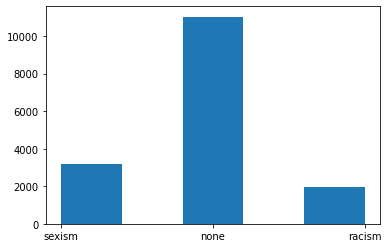

In [ ]:
plt.hist(df['Class'], bins=5)

Th dataset is imbalanced

(array([4.000e+00, 2.000e+01, 3.800e+01, 1.290e+02, 1.860e+02, 1.570e+02,
        2.310e+02, 3.110e+02, 2.600e+02, 3.880e+02, 3.520e+02, 2.800e+02,
        3.620e+02, 4.230e+02, 3.170e+02, 4.280e+02, 3.110e+02, 3.860e+02,
        4.460e+02, 3.230e+02, 3.920e+02, 4.060e+02, 3.140e+02, 4.660e+02,
        4.350e+02, 3.450e+02, 4.490e+02, 4.840e+02, 3.270e+02, 5.090e+02,
        4.070e+02, 5.250e+02, 5.910e+02, 4.560e+02, 6.950e+02, 8.090e+02,
        7.540e+02, 2.178e+03, 1.960e+02, 4.000e+01, 3.000e+00, 1.000e+00,
        0.000e+00, 0.000e+00, 1.000e+00]),
 array([  4.        ,   7.64444444,  11.28888889,  14.93333333,
         18.57777778,  22.22222222,  25.86666667,  29.51111111,
         33.15555556,  36.8       ,  40.44444444,  44.08888889,
         47.73333333,  51.37777778,  55.02222222,  58.66666667,
         62.31111111,  65.95555556,  69.6       ,  73.24444444,
         76.88888889,  80.53333333,  84.17777778,  87.82222222,
         91.46666667,  95.11111111,  98.75555556, 102.4

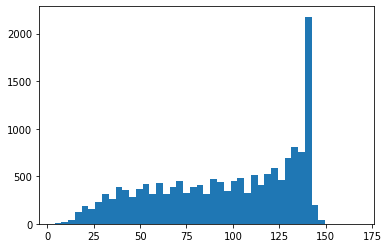

In [ ]:
plt.hist(df['Tweets'].str.len(), bins=45)
#number of characters present in each sentence

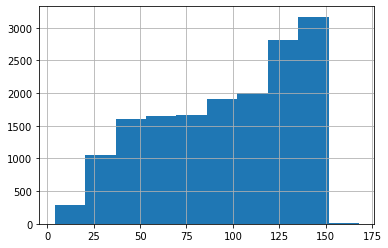

In [ ]:
df['Tweets'].str.len().hist()

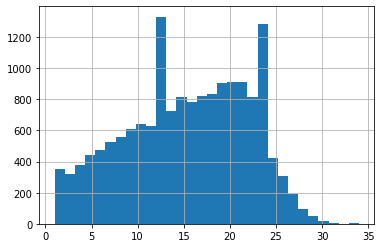

In [ ]:
#Number of words appearing in each tweet
df['Tweets'].str.split().\
    map(lambda x: len(x)).\
    hist(bins=30)

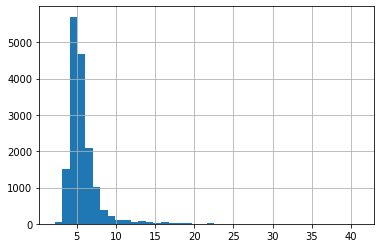

In [ ]:
#Average word length in each sentence
df['Tweets'].str.split().\
   apply(lambda x : [len(i) for i in x]). \
   map(lambda x: np.mean(x)).hist(bins=40)

Bar graph using hashtag frequency as features

**Data Preprocessing**

**Spelling correction**

Check whether any mispellings in dataframe

In [ ]:
pip install pyspellchecker

     |████████████████████████████████| 2.5MB 5.9MB/s 


In [ ]:
#If any incorrect spellings are present
from spellchecker import SpellChecker
spell = SpellChecker()
misspelled = spell.unknown(df['Tweets'])
print(misspelled)

{'@she_thewolf are you a feminist?', 'fuck me #mkr', '@stephenpeel1 wow sexual humor a+', '@mitchmerry yup!', 'shingy http://t.co/lmrdnix3et', '@ohsosoftley yep, not sexist at all!', 'where is this place? #mkr #mkr2015', '@fuxnet aw. are your jimmies rustled?', '@joebentley10 yup. :d', 'also, linux sucks.', "'bloody' sorbet.  #mkr", 'come on toowoomba girls #mkr', 'what. ? #mkr \r\n\r\nthat was. not ok.', 'wait.. who respects colin...  #mkr', 'what is this shit? #mkr', 'hope vicky and celine leave #mkr', '@justdavidvideos yeah...', '@beckajbrown @handzofzues why?', '@alqnasalelamy http://t.co/qnb00f3coa', '#mkr just go home already.', '@amarinaw you, too.', '@joemowens newp.', "@brenbarber it's well articulated.", 'http://t.co/nxgtqslchg', '@captain_panties blackmilk.', 'obviously natural blondes!! #mkr', '@tobyrobertbull outside, dingbat.', 'sounds good. #killerblondes #mkr', '@paulbalbas 2 hours', '@elplatt @thequinnspiracy babies', '@mhoye been there', '@chubssays ...for life.  yes.

In [ ]:
#pip install manual-spellchecker

**Expanding contractions**

In [ ]:
pip install contractions

     |████████████████████████████████| 245kB 4.2MB/s 
     |████████████████████████████████| 317kB 31.6MB/s 
  Created wheel for pyahocorasick: filename=pyahocorasick-1.4.0-cp36-cp36m-linux_x86_64.whl size=81701 sha256=72bd636301652b27ebc730536b4bb51a373bf3faf5dc9ee28adda3e6712b48d0
  Stored in directory: /root/.cache/pip/wheels/0a/90/61/87a55f5b459792fbb2b7ba6b31721b06ff5cf6bde541b40994
Successfully built pyahocorasick


In [ ]:
import contractions

In [ ]:
df['clean_tweet']=df['Tweets'].apply(lambda x: str(contractions.fix(x)))

In [ ]:
df[['Tweets','clean_tweet']].head(20)

,Tweets,clean_tweet
0,Oh yeah Colin! Smash those girls! :D #MKR,Oh yeah Colin! Smash those girls! :D #MKR
1,It's insane they keep bringing people back. When will this show end #MKR,it is insane they keep bringing people back. When will this show end #MKR
2,"@berkeley_eagle #MKR this shit show has more comebacks than Johnny Farnham, ok back to the #TheVoiceAu","@berkeley_eagle #MKR this shit show has more comebacks than Johnny Farnham, ok back to the #TheVoiceAu"
3,*sigh* oh Colin ? #MKR,*sigh* oh Colin ? #MKR
4,"RT @brian_day15: I swear, I'm not sexist, but I honestly just cannot stand the woman college football announcer on ESPN2","RT @brian_day15: I swear, I am not sexist, but I honestly just cannot stand the woman college football announcer on ESPN2"
5,"@jbromley29 Science is only good when it says men can't be monogamous or some shit, amirite??","@jbromley29 Science is only good when it says men can not be monogamous or some shit, amirite??"
6,RT @TheDarkManChris: Call me sexist but I think some women are seriously lacking knowledge l when it comes to feminism #random,RT @TheDarkManChris: Call me sexist but I think some women are seriously lacking knowledge l when it comes to feminism #random
7,"RT @HannahCamille20: Call me sexist, but females really need to stop acting like they are big football fans. Just stop.","RT @HannahCamille20: Call me sexist, but females really need to stop acting like they are big football fans. Just stop."
8,RT @Yandiisa_: The mine is no place for a woman to work... Call me sexist but a woman as a rock driller is not practical.,RT @Yandiisa_: The mine is no place for a woman to work... Call me sexist but a woman as a rock driller is not practical.
9,"RT @Lex_Naija: And don't call me sexist for that last tweet. If women want equal praise for success, they gotta take equal blame for failur?","RT @Lex_Naija: And do not call me sexist for that last tweet. If women want equal praise for success, they got to take equal blame for failur?"


from pycontractions import Contractions

In [ ]:
df['clean_tweet']=df['clean_tweet'].str.replace('MKR','mega kack reiz')
df['clean_tweet']=df['clean_tweet'].str.replace('mkr','mega kack reiz')

In [ ]:
df['clean_tweet'].head()

0                                                                         Oh yeah Colin! Smash those girls! :D #mega kack reiz
1                                         it is insane they keep bringing people back. When will this show end #mega kack reiz
2           @berkeley_eagle #mega kack reiz  this shit show has more comebacks than Johnny Farnham, ok back to the #TheVoiceAu
3                                                                                            *sigh* oh Colin ? #mega kack reiz
4    RT @brian_day15: I swear, I am not sexist, but I honestly just cannot stand the woman college football announcer on ESPN2
Name: clean_tweet, dtype: object

**Hagtag Segmentation**

In [ ]:
pip install wordninja

     |████████████████████████████████| 542kB 4.2MB/s 
  Created wheel for wordninja: filename=wordninja-2.0.0-cp36-none-any.whl size=541553 sha256=a1e821cadc416ba9aeed7cb67552050cd3676a92fde15ca476629fb31412ebcc
  Stored in directory: /root/.cache/pip/wheels/22/46/06/9b6d10ed02c85e93c3bb33ac50e2d368b2586248f192a2e22a
Successfully built wordninja


In [ ]:
import wordninja
#hashtag extract t new column
df['hashtag'] = df['clean_tweet'].apply(lambda x: re.findall(r"#(\w+)", x))

In [ ]:
for i in range(len(df['clean_tweet'])):
  a=df['clean_tweet'][i].split("#")
  b=[]
  j=0
  if(df['clean_tweet'][i][0]=='#'):
    j=0
  else:
    b.append(a[0])
    j=1
  for l in range(j,len(a)):
    c=a[l].split()
    if(len(c)>0):
      d=wordninja.split(c[0])
      for token in d:
        b.append(token)
      for k in range(1,len(c)):
        b.append(c[k])
  df['clean_tweet'][i]=' '.join(b)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [ ]:
d = pd.DataFrame(df[['Tweets','clean_tweet']])
d.head()

,Tweets,clean_tweet
0,Oh yeah Colin! Smash those girls! :D #MKR,Oh yeah Colin! Smash those girls! :D mega kack reiz
1,It's insane they keep bringing people back. When will this show end #MKR,it is insane they keep bringing people back. When will this show end mega kack reiz
2,"@berkeley_eagle #MKR this shit show has more comebacks than Johnny Farnham, ok back to the #TheVoiceAu","@berkeley_eagle mega kack reiz this shit show has more comebacks than Johnny Farnham, ok back to the The Voice Au"
3,*sigh* oh Colin ? #MKR,*sigh* oh Colin ? mega kack reiz
4,"RT @brian_day15: I swear, I'm not sexist, but I honestly just cannot stand the woman college football announcer on ESPN2","RT @brian_day15: I swear, I am not sexist, but I honestly just cannot stand the woman college football announcer on ESPN2"


**Emoticons removal**

In [ ]:
pip install emot

In [ ]:
import emot

In [ ]:
#replacing emoji with text
def replace_emoticons(text):
    emoticons=emot.emoticons(text)
    print(emojis)
    if emoticons["flag"] ==True:
     n=len(emoticons['value'])
     for i in range(n):
       emoticons=emot.emoticons(text)
       l=list(text)
       start_idx=emoticons['location'][0][0]
       end_idx=emoticons['location'][0][1]
       l[start_idx:end_idx+1]=emoticons['mean'][0]
       text=''.join(l)
       print(text)
     return text
df['emoticons'] = df['clean_tweet'].head(1).apply(replace_emoticons)



{'value': [':D'], 'location': [[34, 36]], 'mean': ['Laughing, big grin or laugh with glasses'], 'flag': True}
Oh yeah Colin! Smash those girls! Laughing, big grin or laugh with glasses mega kack reiz


In [ ]:
#removing emojis
from emot.emo_unicode import UNICODE_EMO, EMOTICONS
# Function for removing emoticons
def remove_emoticons(text):
    emoticon_pattern = re.compile(u'(' + u'|'.join(k for k in EMOTICONS) + u')')
    return emoticon_pattern.sub(r'', text)
df['clean_tweet'] = df['clean_tweet'].apply(remove_emoticons)

In [ ]:
clean_tweets = []
for index, row in df.iterrows():
    tweet = str(row['clean_tweet'])
    #clean_tweets.append(' '.join(re.sub("(www\.[^\s]+)|(http://[A-Za-z0-9/]+)|(https?://[^\s]+)|(http?://[^\s]+)"," ",tweet).split()))
    clean_tweets.append(' '.join(re.sub("https\S+|http\S+|www.\S+"," ",tweet).split()))

#print(clean_tweets)
df['clean_tweet'] = clean_tweets

In [ ]:
clean_tweets = []
for index, row in df.iterrows():
    tweet = str(row['clean_tweet'])
    clean_tweets.append(' '.join(re.sub("(&amp;)|(&gt;)|(&lt;)|(\r)|(\n)|(@[A-Za-z0-9_]+)|([^0-9A-Za-z \t])|(\w+:\/\/\S+)|(<.*?>)|(RT)"," ",tweet).split()))
    #print(clean_tweets)
df['clean_tweet'] = clean_tweets
#|(www\.[^\s]+)|(http://[A-Za-z0-9/]+)|(https?://[^\s]+)|(http?://[^\s]+)

In [ ]:
df[['Tweets','clean_tweet']]

,Tweets,clean_tweet
0,Oh yeah Colin! Smash those girls! :D #MKR,Oh yeah Colin Smash those girls mega kack reiz
1,It's insane they keep bringing people back. When will this show end #MKR,it is insane they keep bringing people back When will this show end mega kack reiz
2,"@berkeley_eagle #MKR this shit show has more comebacks than Johnny Farnham, ok back to the #TheVoiceAu",mega kack reiz this shit show has more comebacks than Johnny Farnham ok back to the The Voice Au
3,*sigh* oh Colin ? #MKR,sigh oh Colin mega kack reiz
4,"RT @brian_day15: I swear, I'm not sexist, but I honestly just cannot stand the woman college football announcer on ESPN2",I swear I am not sexist but I honestly just cannot stand the woman college football announcer on ESPN2
5,"@jbromley29 Science is only good when it says men can't be monogamous or some shit, amirite??",Science is only good when it says men can not be monogamous or some shit amirite
6,RT @TheDarkManChris: Call me sexist but I think some women are seriously lacking knowledge l when it comes to feminism #random,Call me sexist but I think some women are seriously lacking knowledge l when it comes to feminism random
7,"RT @HannahCamille20: Call me sexist, but females really need to stop acting like they are big football fans. Just stop.",Call me sexist but females really need to stop acting like they are big football fans Just stop
8,RT @Yandiisa_: The mine is no place for a woman to work... Call me sexist but a woman as a rock driller is not practical.,The mine is no place for a woman to work Call me sexist but a woman as a rock driller is not practical
9,"RT @Lex_Naija: And don't call me sexist for that last tweet. If women want equal praise for success, they gotta take equal blame for failur?",And do not call me sexist for that last tweet If women want equal praise for success they got to take equal blame for failur


In [ ]:
misspelled = spell.unknown(df['clean_tweet'])
print(misspelled)

{'', 'i do not knoooow but it is so good', 'da womenz dey be sooo oppwessed htt', 'i am reading about it now', 'to some yeah', 'shoot me an email randi io', 'that is one really big patch', 'aww yay ash and camila mega kack reiz', 'karma kat karma mega kack reiz', 'my new mascot', 'that explains his dedication to islam', 'an ex coworker gave it to me', 'nope 34 in september', 'anyone have a video of this', 'well said manu mega kack reiz', 'eugh piss off kat mega kack reiz', 'got some evidence for that', 'i am grandma', 'exactly this', 'i am not sexist but', 'the hunger games mega kack reiz', 'we need to outlaw islam outright', 'i hate kat so much mega kack reiz', 'who cares who said it it is true', 'some good stuff here', 'it was private messages', 'not gunmen muslim terrorists', 'no true feminist', 'utterly insane article', 'you are lying', 'but lfr is derp', 'look up the word taqiyya', 'worst drive', 'that would be awesome', 'being blocked is not harassment', 'glad to hear from the ex

**Normalising text**

In [ ]:
min_threshold_rep = 3
df['clean_tweet']= df['clean_tweet'].str.replace(r'(\w)\1{%d,}'%(min_threshold_rep-1), r'\1')

In [ ]:
misspelled = spell.unknown(df['clean_tweet'])
print(misspelled)

{'', 'i am reading about it now', 'to some yeah', 'shoot me an email randi io', 'that is one really big patch', 'aww yay ash and camila mega kack reiz', 'karma kat karma mega kack reiz', 'my new mascot', 'that explains his dedication to islam', 'an ex coworker gave it to me', 'nope 34 in september', 'anyone have a video of this', 'well said manu mega kack reiz', 'eugh piss off kat mega kack reiz', 'got some evidence for that', 'i am grandma', 'exactly this', 'i am not sexist but', 'the hunger games mega kack reiz', 'we need to outlaw islam outright', 'i hate kat so much mega kack reiz', 'who cares who said it it is true', 'some good stuff here', 'it was private messages', 'not gunmen muslim terrorists', 'no true feminist', 'utterly insane article', 'you are lying', 'but lfr is derp', 'look up the word taqiyya', 'worst drive', 'mega kack reiz oh no goodluck you all', 'that would be awesome', 'being blocked is not harassment', 'glad to hear from the experts', 'yep not sexist at all', 'sh

In [ ]:
df['clean_tweet']=df['clean_tweet'].str.lower()

**Replacement of slang words**

In [ ]:
d = {'luv':'love','wud':'would','lyk':'like','wateva':'whatever','ttyl':'talk to you later',
               'kul':'cool','fyn':'fine','fam':'family','bruh':'brother',
               'cud':'could','fud':'food','bc':'because','rofl':'rolling on the floor laughing','ig':'i guess','idc':'í dont care','omg':'oh my god','m kr':'make this dump','wat':'what','lol':'laugh out loud','lmao':'laughing my ass out','lemme':'let me','wut':'what'}

In [ ]:
df['clean_tweet'] = df['clean_tweet'].apply(lambda x : ' '.join(d[word] if word in d else word for word in x.split()))

In [ ]:
df['tokens'] = df['clean_tweet'].apply(lambda x: x.split())

**Stopword Removal**

In [ ]:
nltk.download('stopwords')
from nltk.corpus import stopwords

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
import matplotlib.pyplot as plt

<BarContainer object of 15 artists>

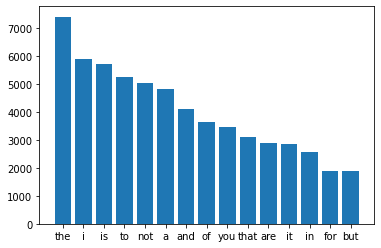

In [ ]:
#The most common stop words present
stop=stopwords.words('english')
# stop_words.extend(["#ff", "ff", "rt"])
stop=set(stopwords.words('english')) 
new= df['clean_tweet'].str.split()
new=new.values.tolist()
corpus=[word for i in new for word in i]
from collections import defaultdict
dic=defaultdict(int)
for word in corpus:
        if word in stop:
            dic[word]+=1
            
top=sorted(dic.items(), key=lambda x:x[1],reverse=True)[:15] 
x,y=zip(*top)
plt.bar(x,y)

In [ ]:
from collections import  Counter

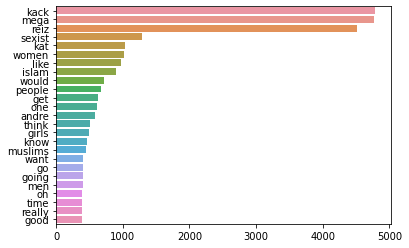

In [ ]:
#The most common words other than stop words
new= df['clean_tweet'].str.split()
new=new.values.tolist()
corpus=[word for i in new for word in i]
counter=Counter(corpus)
most=counter.most_common()
x, y=[], []
for word,count in most[:90]:
        if (word not in stop):
            x.append(word)
            y.append(count)
            
sns.barplot(x=y,y=x)

In [ ]:
#remove stopwords
stop=stopwords.words('english')
#stop=stopwords.words('english')
notstop=['no','nor','not','never', "cannot" ,"wont"]
for ele in notstop:
  if ele in stop:
    stop.remove(ele)
print(stop)
#stop.append("au")
#stop.append("ok")
df['stopremoved']=df['tokens'].apply(lambda x:' '.join( [item for item in x if item not in stop]))
df.head()

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'only', 'own', 'same', 'so', 'than', 'too', 'very', 's', '

,ID,Unnamed: 0,Authors,Descriptions,Favorite Count,Follower Count,Hashtags,Locations,Time Tweeted,Tweets,User Mentions,Class,Neg_Sent,Compound,clean_tweet,hashtag,tokens,stopremoved
0,319399851215433729,2004,CreatrixKali,Literary Creatrix for Alternative SpiritMag. Composer of articles of quirk and sometimes even remotely interesting status updates. And I'm in a book! Link below,0,169,"[{'text': 'MKR', 'indices': [37, 41]}]",Australia,2013-04-03 10:43:53,Oh yeah Colin! Smash those girls! :D #MKR,[],sexism,0.000,0.7793,oh yeah colin smash those girls mega kack reiz,[mega],"[oh, yeah, colin, smash, those, girls, mega, kack, reiz]",oh yeah colin smash girls mega kack reiz
1,320817818222358529,5148,quincepoacher,"AKA Queenotisblue. Sociology, politics, policy, food, Gen Xer, Coburger & grumpy old lady. Social justice, education & employment stuff.",0,425,"[{'text': 'MKR', 'indices': [68, 72]}]",Melbourne,2013-04-07 08:38:23,It's insane they keep bringing people back. When will this show end #MKR,[],none,0.184,-0.4019,it is insane they keep bringing people back when will this show end mega kack reiz,[mega],"[it, is, insane, they, keep, bringing, people, back, when, will, this, show, end, mega, kack, reiz]",insane keep bringing people back show end mega kack reiz
2,324114200450437120,5167,MarkTramby,"Mad keen Manly Sea Eagles supporter, love red wine (the better stuff), cricket ( all forms) and my wonderful family",0,330,"[{'text': 'MKR', 'indices': [16, 20]}, {'text': 'TheVoiceAu', 'indices': [92, 103]}]",Brisbane,2013-04-16 10:57:01,"@berkeley_eagle #MKR this shit show has more comebacks than Johnny Farnham, ok back to the #TheVoiceAu","[{'screen_name': 'berkeley_eagle', 'name': 'john G', 'id': 33840083, 'id_str': '33840083', 'indices': [0, 15]}]",none,0.208,-0.4678,mega kack reiz this shit show has more comebacks than johnny farnham ok back to the the voice au,"[mega, TheVoiceAu]","[mega, kack, reiz, this, shit, show, has, more, comebacks, than, johnny, farnham, ok, back, to, the, the, voice, au]",mega kack reiz shit show comebacks johnny farnham ok back voice au
3,326286656854454273,5221,BinnyD,"Reclusive nillionaire Whovian who enjoys television, arts, crafts and poking dead things with a stick.",0,211,"[{'text': 'MKR', 'indices': [18, 22]}]","NSW, Australia",2013-04-22 10:49:35,*sigh* oh Colin ? #MKR,[],none,0.000,0.0000,sigh oh colin mega kack reiz,[mega],"[sigh, oh, colin, mega, kack, reiz]",sigh oh colin mega kack reiz
4,381988216292655104,3612,YesYoureSexist,Inspired by @YesYoureRacist.,0,24041,[],NaN,2013-09-23 03:47:42,"RT @brian_day15: I swear, I'm not sexist, but I honestly just cannot stand the woman college football announcer on ESPN2","[{'screen_name': 'brian_day15', 'name': 'Brian Day', 'id': 392181216, 'id_str': '392181216', 'indices': [3, 15]}]",sexism,0.213,-0.5139,i swear i am not sexist but i honestly just cannot stand the woman college football announcer on espn2,[],"[i, swear, i, am, not, sexist, but, i, honestly, just, cannot, stand, the, woman, college, football, announcer, on, espn2]",swear not sexist honestly cannot stand woman college football announcer espn2


In [ ]:
misspelled = spell.unknown(df['clean_tweet'])
print(misspelled)

{'', 'i am reading about it now', 'to some yeah', 'shoot me an email randi io', 'that is one really big patch', 'aww yay ash and camila mega kack reiz', 'karma kat karma mega kack reiz', 'my new mascot', 'that explains his dedication to islam', 'an ex coworker gave it to me', 'nope 34 in september', 'anyone have a video of this', 'well said manu mega kack reiz', 'eugh piss off kat mega kack reiz', 'got some evidence for that', 'i am grandma', 'exactly this', 'i am not sexist but', 'the hunger games mega kack reiz', 'we need to outlaw islam outright', 'i hate kat so much mega kack reiz', 'who cares who said it it is true', 'some good stuff here', 'it was private messages', 'not gunmen muslim terrorists', 'no true feminist', 'utterly insane article', 'you are lying', 'but lfr is derp', 'look up the word taqiyya', 'worst drive', 'mega kack reiz oh no goodluck you all', 'that would be awesome', 'being blocked is not harassment', 'glad to hear from the experts', 'yep not sexist at all', 'sh

**Lemmatization**

In [ ]:
nltk.download('wordnet')
from nltk.stem import WordNetLemmatizer 

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [ ]:
lemmatizer = WordNetLemmatizer()
df['lemmatizer'] = df['stopremoved'].apply(lambda x : ' '.join([lemmatizer.lemmatize(word) for word in x.split()]))

TextBlob

In [ ]:
pip install textblob

In [ ]:
from textblob import TextBlob, Word

In [ ]:
df['textblob'] = df['stopremoved'].apply(lambda x : ' ')

In [ ]:
 nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
df['textblob'] = df['stopremoved'].apply(lambda x: ' '.join( [ w.lemmatize() for w in TextBlob(x).words]))

In [ ]:
#pip install pattern

In [ ]:
df[['stopremoved','textblob','lemmatizer']]

,stopremoved,textblob,lemmatizer
0,oh yeah colin smash girls mega kack reiz,oh yeah colin smash girl mega kack reiz,oh yeah colin smash girl mega kack reiz
1,insane keep bringing people back show end mega kack reiz,insane keep bringing people back show end mega kack reiz,insane keep bringing people back show end mega kack reiz
2,mega kack reiz shit show comebacks johnny farnham ok back voice au,mega kack reiz shit show comeback johnny farnham ok back voice au,mega kack reiz shit show comeback johnny farnham ok back voice au
3,sigh oh colin mega kack reiz,sigh oh colin mega kack reiz,sigh oh colin mega kack reiz
4,swear not sexist honestly cannot stand woman college football announcer espn2,swear not sexist honestly can not stand woman college football announcer espn2,swear not sexist honestly cannot stand woman college football announcer espn2
5,science good says men not monogamous shit amirite,science good say men not monogamous shit amirite,science good say men not monogamous shit amirite
6,call sexist think women seriously lacking knowledge l comes feminism random,call sexist think woman seriously lacking knowledge l come feminism random,call sexist think woman seriously lacking knowledge l come feminism random
7,call sexist females really need stop acting like big football fans stop,call sexist female really need stop acting like big football fan stop,call sexist female really need stop acting like big football fan stop
8,mine no place woman work call sexist woman rock driller not practical,mine no place woman work call sexist woman rock driller not practical,mine no place woman work call sexist woman rock driller not practical
9,not call sexist last tweet women want equal praise success got take equal blame failur,not call sexist last tweet woman want equal praise success got take equal blame failur,not call sexist last tweet woman want equal praise success got take equal blame failur


Stemming

In [ ]:
from nltk.stem import PorterStemmer

In [ ]:
ps = PorterStemmer()
df['porter'] = df['stopremoved'].apply(lambda x : ' '.join([ps.stem(word) for word in x.split()]))

In [ ]:
from nltk.stem import LancasterStemmer

In [ ]:
ls = LancasterStemmer()
df['lancaster'] = df['stopremoved'].apply(lambda x : ' '.join([ls.stem(word) for word in x.split()]))

In [ ]:
from nltk.stem.snowball import SnowballStemmer 

In [ ]:
df['snowball'] = df['stopremoved'].apply(lambda x : ' '.join([ls.stem(word) for word in x.split()]))

In [ ]:
#df[['stopremoved','lemmatizer','porter','lancaster','snowball']]
df[['stopremoved','porter','lancaster','snowball']]

,stopremoved,porter,lancaster,snowball
0,oh yeah colin smash girls mega kack reiz,oh yeah colin smash girl mega kack reiz,oh yeah colin smash girl meg kack reiz,oh yeah colin smash girl meg kack reiz
1,insane keep bringing people back show end mega kack reiz,insan keep bring peopl back show end mega kack reiz,ins keep bring peopl back show end meg kack reiz,ins keep bring peopl back show end meg kack reiz
2,mega kack reiz shit show comebacks johnny farnham ok back voice au,mega kack reiz shit show comeback johnni farnham ok back voic au,meg kack reiz shit show comeback johnny farnham ok back voic au,meg kack reiz shit show comeback johnny farnham ok back voic au
3,sigh oh colin mega kack reiz,sigh oh colin mega kack reiz,sigh oh colin meg kack reiz,sigh oh colin meg kack reiz
4,swear not sexist honestly cannot stand woman college football announcer espn2,swear not sexist honestli cannot stand woman colleg footbal announc espn2,swear not sex honest cannot stand wom colleg footbal annount espn2,swear not sex honest cannot stand wom colleg footbal annount espn2
5,science good says men not monogamous shit amirite,scienc good say men not monogam shit amirit,sci good say men not monogam shit amirit,sci good say men not monogam shit amirit
6,call sexist think women seriously lacking knowledge l comes feminism random,call sexist think women serious lack knowledg l come femin random,cal sex think wom sery lack knowledg l com femin random,cal sex think wom sery lack knowledg l com femin random
7,call sexist females really need stop acting like big football fans stop,call sexist femal realli need stop act like big footbal fan stop,cal sex fem real nee stop act lik big footbal fan stop,cal sex fem real nee stop act lik big footbal fan stop
8,mine no place woman work call sexist woman rock driller not practical,mine no place woman work call sexist woman rock driller not practic,min no plac wom work cal sex wom rock dril not pract,min no plac wom work cal sex wom rock dril not pract
9,not call sexist last tweet women want equal praise success got take equal blame failur,not call sexist last tweet women want equal prais success got take equal blame failur,not cal sex last tweet wom want eq pra success got tak eq blam fail,not cal sex last tweet wom want eq pra success got tak eq blam fail


**Word visualisation**

In [ ]:
corpus = []
for i in range(0,len(df)):
    tweet = df['porter'][i]
    tweet = tweet.split()
    #tweet = [ps.stem(word) for word in tweet if not word in set(stopwords.words('english'))]
    tweet = ' '.join(tweet)
    corpus.append(tweet)

corpus

['oh yeah colin smash girl mega kack reiz',
 'insan keep bring peopl back show end mega kack reiz',
 'mega kack reiz shit show comeback johnni farnham ok back voic au',
 'sigh oh colin mega kack reiz',
 'swear not sexist honestli cannot stand woman colleg footbal announc espn2',
 'scienc good say men not monogam shit amirit',
 'call sexist think women serious lack knowledg l come femin random',
 'call sexist femal realli need stop act like big footbal fan stop',
 'mine no place woman work call sexist woman rock driller not practic',
 'not call sexist last tweet women want equal prais success got take equal blame failur',
 'sorri not see hot girl eat like guy call sexist like girl girl',
 'everi day think mayb day find no sexist tweet never day keep good fight women',
 'honestli stereotyp light heart usual harmless let peopl joke around',
 'femin respect ideal sensit search problem not',
 'would not mad not fact not appreci call bigot say',
 'sexist tweet women sexism work way',
 'sexis

In [ ]:
pip install wordcloud

In [ ]:
#Ensuring all the tweets are tokenized into individual words
len(corpus)
corpus

['oh yeah colin smash girl mega kack reiz',
 'insan keep bring peopl back show end mega kack reiz',
 'mega kack reiz shit show comeback johnni farnham ok back voic au',
 'sigh oh colin mega kack reiz',
 'swear not sexist honestli cannot stand woman colleg footbal announc espn2',
 'scienc good say men not monogam shit amirit',
 'call sexist think women serious lack knowledg l come femin random',
 'call sexist femal realli need stop act like big footbal fan stop',
 'mine no place woman work call sexist woman rock driller not practic',
 'not call sexist last tweet women want equal prais success got take equal blame failur',
 'sorri not see hot girl eat like guy call sexist like girl girl',
 'everi day think mayb day find no sexist tweet never day keep good fight women',
 'honestli stereotyp light heart usual harmless let peopl joke around',
 'femin respect ideal sensit search problem not',
 'would not mad not fact not appreci call bigot say',
 'sexist tweet women sexism work way',
 'sexis

Creating new column class_num

In [ ]:
df['class_num']=df['Class']
for i in range(len(df['Class'])):
  if df['Class'][i]=="none":
    df['class_num'][i]=0
  elif df['Class'][i]=="sexism":
    df['class_num'][i]=1
  elif df['Class'][i]=="racism":
    df['class_num'][i]=2

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
from wordcloud import WordCloud

Normal words


(-0.5, 799.5, 499.5, -0.5)

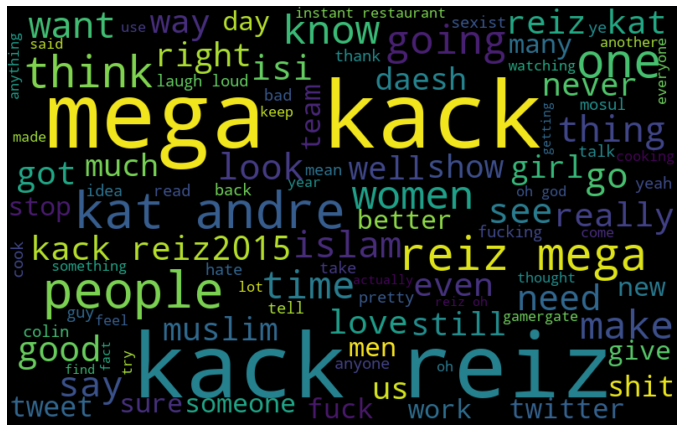

In [ ]:
normal_words = ' '.join([word for word in df['stopremoved'][df['class_num'] == 0]])
wordcloud = WordCloud(width = 800, height = 500, max_font_size = 110,max_words = 100).generate(normal_words)
print('Normal words')
plt.figure(figsize= (12,8))
plt.imshow(wordcloud, interpolation = 'bilinear',cmap='viridis')
plt.axis('off')

Sexist words


(-0.5, 799.5, 499.5, -0.5)

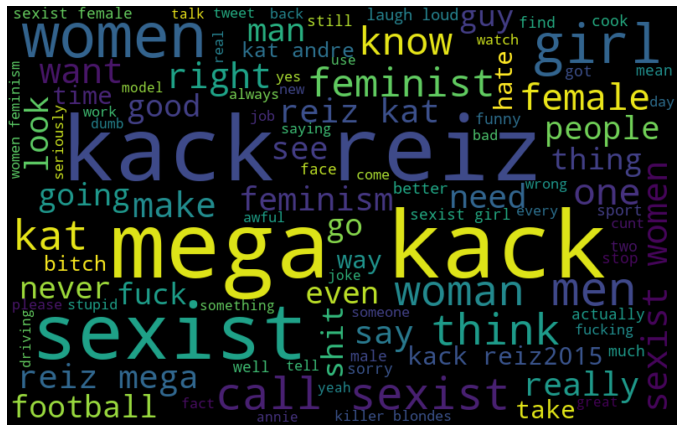

In [ ]:
normal_words = ' '.join([word for word in df['stopremoved'][df['class_num'] == 1]])
wordcloud = WordCloud(width = 800, height = 500, max_font_size = 110,max_words = 100).generate(normal_words)
print('Sexist words')
plt.figure(figsize= (12,8))
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')

Racist words


(-0.5, 799.5, 499.5, -0.5)

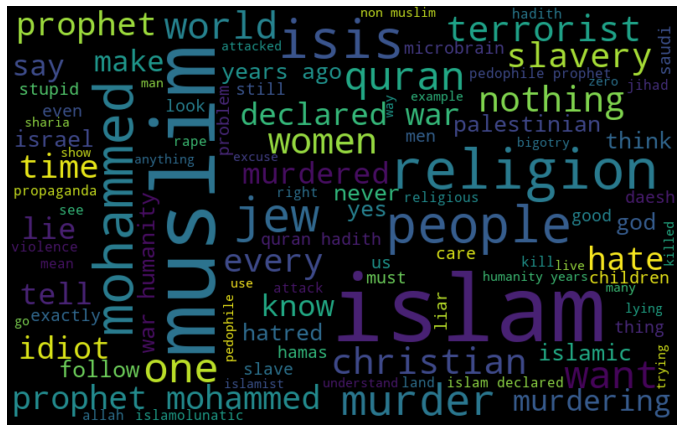

In [ ]:
normal_words = ' '.join([word for word in df['stopremoved'][df['class_num'] == 2]])
wordcloud = WordCloud(width = 800, height = 500, max_font_size = 110,max_words = 100).generate(normal_words)
print('Racist words')
plt.figure(figsize= (12,8))
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')

**Tokenisation**

In [ ]:
pip install memory_profiler

In [ ]:
%load_ext memory_profiler

In [ ]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

**word_tokenize**

In [ ]:
%%time
%%memit
from nltk.tokenize import word_tokenize
df['word_tokenize'] = df['clean_tweet']
for i in range(len(df['clean_tweet'])):
        df['word_tokenize'][i] = word_tokenize(df['clean_tweet'][i])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


peak memory: 452.59 MiB, increment: 9.69 MiB
CPU times: user 6.52 s, sys: 90.6 ms, total: 6.61 s
Wall time: 6.75 s


In [ ]:
%%time
%%memit
from nltk.tokenize import TreebankWordTokenizer
df['TreebankWordTokenizer'] = df['clean_tweet']
for i in range(len(df['clean_tweet'])):
        df['TreebankWordTokenizer'][i] = TreebankWordTokenizer().tokenize(df['clean_tweet'][i])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


peak memory: 468.65 MiB, increment: 16.06 MiB
CPU times: user 5.5 s, sys: 94.9 ms, total: 5.6 s
Wall time: 5.74 s


**WordPunctTokenizer**

In [ ]:
%%time
%%memit
from nltk.tokenize import WordPunctTokenizer 
     
# Create a reference variable for Class WordPunctTokenizer 
tk = WordPunctTokenizer() 
     
df['WordPunctTokenizer'] = df['clean_tweet']
for i in range(len(df['clean_tweet'])):
        df['WordPunctTokenizer'][i] = tk.tokenize(df['clean_tweet'][i])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


peak memory: 484.65 MiB, increment: 15.92 MiB
CPU times: user 3.79 s, sys: 78.9 ms, total: 3.87 s
Wall time: 4.01 s


**WhitespaceTokenizer**

In [ ]:
%%time
%%memit
# import WhitespaceTokenizer() method from nltk 
from nltk.tokenize import WhitespaceTokenizer 
     
# Create a reference variable for Class WhitespaceTokenizer 
tk = WhitespaceTokenizer() 
     
df['WhitespaceTokenizer'] = df['clean_tweet']
for i in range(len(df['clean_tweet'])):
        df['WhitespaceTokenizer'][i] = tk.tokenize(df['clean_tweet'][i])

UsageError: Cell magic `%%memit` not found.


In [ ]:
d = pd.DataFrame(df[['Tweets','clean_tweet','word_tokenize','TreebankWordTokenizer','WordPunctTokenizer','WhitespaceTokenizer']])
d

Selected df['WhitespaceTokenizer']
Since data is already clean and do not contain any punctuations or contractions

In [ ]:
df['tokens'] = df['clean_tweet'].apply(lambda x: x.split())

**Feature Extraction**

Bag of Words
 

In [ ]:
#bow_vectorizer = CountVectorizer(max_df=0.90, min_df=2, max_features=1000, stop_words='english')
#bow = bow_vectorizer.fit_transform(df['stopremoved'])
#df_bow = pd.DataFrame(bow.todense())
#df_bow

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
bow_vectorizer = CountVectorizer()
X_bow = bow_vectorizer.fit_transform(df['porter']).toarray()
Y1 = df.loc[:,'Class'].values

TF-IDF

In [ ]:

from sklearn.feature_extraction.text import TfidfVectorizer
tfidf_vectorizer = TfidfVectorizer()
# TF-IDF feature matrix
X1 = tfidf_vectorizer.fit_transform(df['porter']).toarray()
Y1 = df.loc[:,'Class'].values

In [ ]:
len(X1)

16135

glove embeddings
doc2vec
https://www.sciencedirect.com/science/article/pii/S1877050919314152/pdf?md5=dae1f1e0961756ab09df93e29e77d7a3&pid=1-s2.0-S1877050919314152-main.pdf

In [ ]:
len(X1[0])

10350

In [ ]:
X1.shape

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X1, Y1, test_size = 0.3, random_state=0, shuffle = True)

In [ ]:
X_train.shape

In [ ]:
X_test.shape

In [ ]:
X_test=X_test[:2000]

Lsa

In [ ]:
from sklearn.decomposition import TruncatedSVD

In [ ]:
lsa = TruncatedSVD(n_components=30,n_iter=100)

In [ ]:
x_train_svd = lsa.fit_transform(X_train)

In [ ]:
x_test_svd = lsa.transform(X_test)

LSA

In [ ]:
svd = TruncatedSVD(n_components=8000)

In [ ]:
x_test_svd = svd.transform(X_train)

In [ ]:
from sklearn.decomposition import TruncatedSVD

from sklearn.model_selection import train_test_split

In [ ]:
tfidf_vec = TfidfVectorizer(use_idf=True, norm='l2')
lsa = TruncatedSVD(n_components=15,n_iter=100)

In [ ]:
d = pd.DataFrame(df[['porter','class_num']])
x = d.porter
y = d.class_num

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=42)
transformed_x_train = tfidf_vec.fit_transform(x_train)
transformed_x_test = tfidf_vec.transform(x_test)
print('TF-IDF output shape:', transformed_x_train.shape)

In [ ]:
x_train_svd = svd.fit_transform(transformed_x_train)


In [ ]:
x_test_svd = svd.transform(transformed_x_test)

In [ ]:
print('LSA output shape:', x_train_svd.shape)

In [ ]:
print('LSA output shape:', x_test_svd.shape)

In [ ]:
explained_variance = svd.explained_variance_ratio_.sum()
print("Sum of explained variance ratio: %d%%" % (int(explained_variance * 100)))

In [ ]:
X_train.shape

**CHI - Dimensionality Reduction**

In [ ]:
plt.style.use('fivethirtyeight')
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [ ]:
df.head()

In [ ]:
d = pd.DataFrame(df[['clean_tweet','class_num']])
d.head()

In [ ]:
d.dropna(inplace=True)
d.reset_index(drop=True,inplace=True)
d.info()

Chi - Train / Dev / Test Split

In [ ]:
x = d.clean_tweet
y = d.class_num
y=y.astype('int')

In [ ]:
from sklearn.model_selection import train_test_split
SEED = 2000
x_train, x_validation_and_test, y_train, y_validation_and_test = train_test_split(x, y, test_size=.02, random_state=SEED)
x_validation, x_test, y_validation, y_test = train_test_split(x_validation_and_test, y_validation_and_test, test_size=.5, random_state=SEED)

In [ ]:
print("Train set has total {0} entries with {1:.2f}% none, {2:.2f}% sexism, {3:.2f}% racism".format(len(x_train),(len(x_train[y_train == 0]) / (len(x_train)*1.))*100,(len(x_train[y_train == 1]) / (len(x_train)*1.))*100,(len(x_train[y_train == 2]) / (len(x_train)*1.))*100))
print("Validation set has total {0} entries with {1:.2f}% none, {2:.2f}% sexism, {3:.2f}% racism".format(len(x_validation),(len(x_validation[y_validation == 0]) / (len(x_validation)*1.))*100,(len(x_validation[y_validation == 1]) / (len(x_validation)*1.))*100,(len(x_validation[y_validation == 2]) / (len(x_validation)*1.))*100))
print("Test set has total {0} entries with {1:.2f}% none, {2:.2f}% sexism, {3:.2f}% racism".format(len(x_test),(len(x_test[y_test == 0]) / (len(x_test)*1.))*100,(len(x_test[y_test == 1]) / (len(x_test)*1.))*100,(len(x_test[y_test == 2]) / (len(x_test)*1.))*100))                                                                            
                                                                                                                                                                                                                                  

In [ ]:
from textblob import TextBlob
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report, confusion_matrix

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from time import time

In [ ]:
def accuracy_summary(pipeline, x_train, y_train, x_test, y_test):
    if len(x_test[y_test == 0]) / (len(x_test)*1.) > 0.5:
        null_accuracy = len(x_test[y_test == 0]) / (len(x_test)*1.)
    else:
        null_accuracy = 1. - (len(x_test[y_test == 0]) / (len(x_test)*1.))
    t0 = time()
    sentiment_fit = pipeline.fit(x_train, y_train)
    y_pred = sentiment_fit.predict(x_test)
    train_test_time = time() - t0
    accuracy = accuracy_score(y_test, y_pred)
    print("null accuracy: {0:.2f}%".format(null_accuracy*100))
    print("accuracy score: {0:.2f}%".format(accuracy*100))
    if accuracy > null_accuracy:
        print("model is {0:.2f}% more accurate than null accuracy".format((accuracy-null_accuracy)*100))
    elif accuracy == null_accuracy:
        print("model has the same accuracy with the null accuracy")
    else:
        print("model is {0:.2f}% less accurate than null accuracy".format((null_accuracy-accuracy)*100))
    print("train and test time: {0:.2f}s".format(train_test_time))
    print("-"*80)
    return accuracy, train_test_time

In [ ]:
cvec = CountVectorizer()
lr = LogisticRegression()
n_features = np.arange(1000,8001,1000)

def nfeature_accuracy_checker(vectorizer=cvec, n_features=n_features, stop_words=None, ngram_range=(1, 1), classifier=lr):
    result = []
    print (classifier)
    print("\n")
    for n in n_features:
        vectorizer.set_params(stop_words=stop_words, max_features=n, ngram_range=ngram_range)
        checker_pipeline = Pipeline([
            ('vectorizer', vectorizer),
            ('classifier', classifier)
        ])
        print("Validation result for {} features".format(n))
        nfeature_accuracy,tt_time = accuracy_summary(checker_pipeline, x_train, y_train, x_validation, y_validation)
        result.append((n,nfeature_accuracy,tt_time))
    return result

Chi - TF-IDF

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
tvec = TfidfVectorizer()

In [ ]:
%%time
print("RESULT FOR TRIGRAM WITH STOP WORDS (Tfidf)\n")
feature_result_tgt = nfeature_accuracy_checker(vectorizer=tvec,ngram_range=(1, 3))

In [ ]:
nfeatures_plot_tgt = pd.DataFrame(feature_result_tgt,columns=['nfeatures','validation_accuracy','train_test_time'])

In [ ]:
from gensim.models import Doc2Vec

In [ ]:
def get_concat_vectors(model1,model2, corpus, size):
    vecs = np.zeros((len(corpus), size))
    n = 0
    for i in corpus.index:
        prefix = 'all_' + str(i)
        vecs[n] = np.append(model1.docvecs[prefix],model2.docvecs[prefix])
        n += 1
    return vecs

Chi - Dimensionality Reduction

In [ ]:
tvec = TfidfVectorizer(max_features=8000,ngram_range=(1, 3))
x_train_tfidf = tvec.fit_transform(x_train)
x_validation_tfidf = tvec.transform(x_validation)

In [ ]:
from sklearn.feature_selection import chi2
chi2score = chi2(x_train_tfidf, y_train)[0]

top 20 features

In [ ]:
plt.figure(figsize=(15,10))
wscores = zip(tvec.get_feature_names(), chi2score)
wchi2 = sorted(wscores, key=lambda x:x[1])
topchi2 = list(zip(*wchi2[-20:]))
#topchi2 = list(zip(*topchi2))
x = range(len(topchi2[1]))
labels = topchi2[0]
plt.barh(x,str(topchi2[1]), align='center', alpha=0.2)
plt.plot(topchi2[1], x, '-o', markersize=5, alpha=0.8)
plt.yticks(x, labels)
plt.xlabel('$\chi^2$')#

In [ ]:
from sklearn.feature_selection import SelectKBest, chi2
ch2_result = []
for n in np.arange(1000,8000,1000):
    ch2 = SelectKBest(chi2, k=n)
    x_train_chi2_selected = ch2.fit_transform(x_train_tfidf, y_train)
    x_validation_chi2_selected = ch2.transform(x_validation_tfidf)
    clf = LogisticRegression()
    clf.fit(x_train_chi2_selected, y_train)
    score = clf.score(x_validation_chi2_selected, y_validation)
    ch2_result.append(score)
    print("chi2 feature selection evaluation calculated for {} features".format(n))

In [ ]:
print(ch2_result)

In [ ]:
plt.figure(figsize=(8,6))
plt.plot(nfeatures_plot_tgt.nfeatures, nfeatures_plot_tgt.validation_accuracy,label='trigram tfidf vectorizer',color='royalblue')
plt.plot(np.arange(1000,8000,1000), ch2_result,label='tfidf dimesions reduced from 100,000 features',linestyle=':', color='orangered')

plt.title("tfidft vectorizer: features limited within tfidft vectorizer VS reduced dimensions with chi2")
plt.xlabel("Number of features")
plt.ylabel("Validation set accuracy")
plt.legend()

**LSA**

In [ ]:
from sklearn.decomposition import TruncatedSVD
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import Normalizer

In [ ]:
svd = TruncatedSVD(100)
lsa = make_pipeline(svd, Normalizer(copy=False))

In [ ]:
X_lsa = lsa.fit_transform(x)
explained_variance = svd.explained_variance_ratio_.sum()
print("  Explained variance of the SVD step: {}%".format(int(explained_variance * 100)))

In [ ]:
import random
feat_names = v.get_feature_names()

# Print ten random terms from the vocabulary
print("Some random words in the vocabulary:")
for i in range(0, 10):
    featNum = random.randint(0, len(feat_names))
    print("  %s" % feat_names[featNum])

In [ ]:
import numpy
from pylab import *
for compNum in range(0, 10):

    comp = svd.components_[compNum]
    
    # Sort the weights in the first component, and get the indeces
    indeces = numpy.argsort(comp).tolist()
    
    # Reverse the indeces, so we have the largest weights first.
    indeces.reverse()
    
    # Grab the top 10 terms which have the highest weight in this component.        
    terms = [feat_names[weightIndex] for weightIndex in indeces[0:10]]    
    weights = [comp[weightIndex] for weightIndex in indeces[0:10]]    
   
    # Display these terms and their weights as a horizontal bar graph.    
    # The horizontal bar graph displays the first item on the bottom; reverse
    # the order of the terms so the biggest one is on top.
    terms.reverse()
    weights.reverse()
    positions = arange(10) + .5    # the bar centers on the y axis
    
    figure(compNum)
    barh(positions, weights, align='center')
    yticks(positions, terms)
    xlabel('Weight')
    title('Strongest terms for component %d' % (compNum))
    grid(True)
    show()

**Classifier**

**SVM**

In [ ]:
from sklearn import svm

In [ ]:
X_train=X_train[:4000]
Y_train=Y_train[:4000]

In [ ]:
rbf = svm.SVC(kernel='rbf', gamma=1, C=1, decision_function_shape='ovo').fit(X_train, Y_train)

In [ ]:
linear = svm.SVC(kernel='linear', C=1, decision_function_shape='ovo').fit(X_train, Y_train)
rbf = svm.SVC(kernel='rbf', gamma=1, C=1, decision_function_shape='ovo').fit(X_train, Y_train)
poly = svm.SVC(kernel='poly', degree=3, C=1, decision_function_shape='ovo').fit(X_train, Y_train)
sig = svm.SVC(kernel='sigmoid', C=1, decision_function_shape='ovo').fit(X_train, Y_train)

In [ ]:
rbf_pred = rbf.predict(X_test)

In [ ]:
accuracy_rbf = rbf.score(X_test, Y_test)

In [ ]:
print(accuracy_rbf)

In [ ]:
cm_rbf = confusion_matrix(Y_test, rbf_pred)

In [ ]:
print(cm_rbf)

In [ ]:
linear_pred = linear.predict(X_test)
poly_pred = poly.predict(X_test)
rbf_pred = rbf.predict(X_test)
sig_pred = sig.predict(X_test)

In [ ]:
# retrieve the accuracy and print it for all 4 kernel functions
accuracy_lin = linear.score(X_test, y_test)
accuracy_poly = poly.score(X_test, y_test)
accuracy_rbf = rbf.score(X_test, y_test)
accuracy_sig = sig.score(X_test, y_test)
print(“Accuracy Linear Kernel:”, accuracy_lin)
print(“Accuracy Polynomial Kernel:”, accuracy_poly)
print(“Accuracy Radial Basis Kernel:”, accuracy_rbf)
print(“Accuracy Sigmoid Kernel:”, accuracy_sig)

In [ ]:
# creating a confusion matrix
cm_lin = confusion_matrix(y_test, linear_pred)
cm_poly = confusion_matrix(y_test, poly_pred)
cm_rbf = confusion_matrix(y_test, rbf_pred)
cm_sig = confusion_matrix(y_test, sig_pred)
print(cm_lin)
print(cm_poly)
print(cm_rbf)
print(cm_sig)

**KNN**

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

In [ ]:
knn_clf=KNeighborsClassifier()


In [ ]:
knn_clf.fit(X_train,Y_train)

In [ ]:
ypred=knn_clf.predict(X_test)

In [ ]:
Y_test=Y_test[:2000]

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
result = confusion_matrix(Y_test, ypred)

print(result)


In [ ]:
result1 = classification_report(Y_test, ypred)
print (result1)
result2 = accuracy_score(Y_test,ypred)
#print(“Accuracy:”,result2)
print(result2)